In [2]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 80.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 74.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 72.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12


In [3]:
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import glob
import cv2
import pandas as pd
import json
from datetime import datetime
import pandas as pd
from ultralytics import YOLO
import os


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
!pip install yt-dlp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.5/175.5 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 36.8 MB/s eta 0:00:00


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
save_path = '/content/drive/MyDrive/NBA_Projects_Clips'
os.makedirs(save_path, exist_ok=True)

#Python Function to Download & Trim

In [7]:
def download_and_trim(url, output_name, start=None, end=None):
    """
    Download YouTube video (full or trimmed) using yt-dlp
    """
    output_file = f"{save_path}/{output_name}.mp4"
    section = f"--download-sections *{start}-{end}" if start and end else ""
    cmd = f'yt-dlp -f best {section} "{url}" -o "{output_file}"'
    subprocess.run(cmd, shell=True)
    print(f"Downloaded: {output_file}")


In [8]:
video_list = [
    # Format: ("URL", "file_name", "start", "end")
    ("https://www.youtube.com/watch?v=6wU24LJCgM0", "clip1_out_of_bounds_saves", "00:30", "01:00"),
    ("https://www.youtube.com/watch?v=pZ2Zax5E_Ws", "clip2_last_second_play", "00:15", "00:45"),
    ("https://www.youtube.com/watch?v=5iD1R-9fnTo", "clip3_sideline_out_of_bounds", None, None),
    ("https://www.youtube.com/watch?v=w-4cBT8DAXg", "clip4_baseline_out_of_bounds", None, None),
    ("https://www.youtube.com/watch?v=F077jDJV3bE", "clip5_out_of_bounds_shots", None, None),
    ("https://www.youtube.com/watch?v=z4xhHPJ7TXI", "clip6_best_out_of_bounds_saves", None, None),
    ("https://www.youtube.com/watch?v=T9VSZr-Yrcc", "clip7_baseline_plays", None, None),
    ("https://www.youtube.com/watch?v=LMDAoc-CGIU", "clip8_craziest_sequences", None, None),
    ("https://youtu.be/1NtuWcmNa_o", "clip9_sideline_plays", None, None),
    ("https://www.youtube.com/watch?v=rRQbOoUQCQs", "clip10_highIQ_inbounds", None, None),
    ("https://www.youtube.com/watch?v=OyM_np9u1uE", "clip11_out_of_bounds_shots_falling", None, None),
    ("https://www.youtube.com/watch?v=k5HhulIm8Qc", "clip12_inbound_fails", None, None),
    # Repeat or add variations—about 20 unique videos
    # I'm listing 8 initial; you can vary start/end if needed
    ("https://www.youtube.com/watch?v=6wU24LJCgM0", "clip13_repeat1", "01:00", "01:30"),
    ("https://www.youtube.com/watch?v=pZ2Zax5E_Ws", "clip14_repeat2", "00:45", "01:15"),
    ("https://www.youtube.com/watch?v=5iD1R-9fnTo", "clip15_repeat3", "00:00", "00:20"),
    ("https://www.youtube.com/watch?v=w-4cBT8DAXg", "clip16_repeat4", "01:00", "01:20"),
    ("https://www.youtube.com/watch?v=F077jDJV3bE", "clip17_repeat5", "00:30", "00:50"),
    ("https://www.youtube.com/watch?v=z4xhHPJ7TXI", "clip18_repeat6", "00:40", "01:00"),
    ("https://www.youtube.com/watch?v=T9VSZr-Yrcc", "clip19_repeat7", "00:10", "00:30"),
    ("https://www.youtube.com/watch?v=LMDAoc-CGIU", "clip20_repeat8", "02:00", "02:20"),
]


In [9]:
for url, name, start, end in video_list:
    download_and_trim(url, name, start, end)


Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip1_out_of_bounds_saves.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip2_last_second_play.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip3_sideline_out_of_bounds.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip4_baseline_out_of_bounds.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip5_out_of_bounds_shots.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip6_best_out_of_bounds_saves.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip7_baseline_plays.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip8_craziest_sequences.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip9_sideline_plays.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip10_highIQ_inbounds.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip11_out_of_bounds_shots_falling.mp4
Downloaded: /content/drive/MyDrive/NBA_Projects_Clips/clip12_inbound_fail

In [10]:


def extract_frames(video_path, frames_dir, interval=10):
    os.makedirs(frames_dir, exist_ok=True)
    cap = cv2.VideoCapture(video_path)
    count = 0
    frame_no = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        if count % interval == 0:
            cv2.imwrite(f"{frames_dir}/frame_{frame_no}.jpg", frame)
            frame_no += 1
        count += 1
    cap.release()
    print(f"Frames extracted to {frames_dir}")

# Example: Extract frames every 10 frames
extract_frames(f"{save_path}/out_of_bounds_saves.mp4", f"{save_path}/frames_out_of_bounds", interval=10)


Frames extracted to /content/drive/MyDrive/NBA_Projects_Clips/frames_out_of_bounds


#Create a Metadata Builder

In [11]:
metadata_file_csv = f"{save_path}/metadata.csv"
metadata_file_json = f"{save_path}/metadata.json"

def add_video_metadata(video_name, url, start=None, end=None, players=None, event_type="out_of_bounds"):
    data = {
        "video_name": video_name,
        "video_url": url,
        "start_time": start if start else "full_video",
        "end_time": end if end else "full_video",
        "players_involved": players if players else [],
        "event_type": event_type,
        "added_on": datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    }

    # Append to CSV
    try:
        df = pd.read_csv(metadata_file_csv)
    except FileNotFoundError:
        df = pd.DataFrame(columns=data.keys())
    df = pd.concat([df, pd.DataFrame([data])], ignore_index=True)
    df.to_csv(metadata_file_csv, index=False)

    # Append to JSON
    try:
        with open(metadata_file_json, "r") as f:
            json_data = json.load(f)
    except FileNotFoundError:
        json_data = []
    json_data.append(data)
    with open(metadata_file_json, "w") as f:
        json.dump(json_data, f, indent=4)

    print(f"Metadata updated for {video_name}")


In [12]:
df = pd.read_csv(f"{save_path}/metadata.csv")
print(df.head())  # Show first few entries


            video_name                                    video_url  \
0  out_of_bounds_saves  https://www.youtube.com/watch?v=6wU24LJCgM0   

  start_time end_time players_involved     event_type             added_on  
0      00:30    01:00               []  out_of_bounds  2025-08-01 15:51:39  


In [13]:
# Cell 2: Batch extractor (new)

frames_base_path = f"{save_path}/frames"
os.makedirs(frames_base_path, exist_ok=True)

def extract_all_frames(metadata_csv, interval=10):
    df = pd.read_csv(metadata_csv)
    for _, row in df.iterrows():
        video_name = row['video_name']
        video_path = f"{save_path}/{video_name}.mp4"
        output_dir = f"{frames_base_path}/{video_name}"
        extract_frames(video_path, output_dir, interval)

# Run for all videos
extract_all_frames(f"{save_path}/metadata.csv", interval=10)


Frames extracted to /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves


In [14]:
# Path to your extracted frames
frames_dir = f"{save_path}/frames/out_of_bounds_saves"
frame_paths = glob.glob(os.path.join(frames_dir, "*.jpg"))


In [15]:
model = YOLO("yolov8n.pt")  # Pretrained YOLOv8

# Define allowed classes: person (0) and sports ball (32)
allowed_classes = [0, 32]

def detect_and_filter(frame_path, save_path):
    results = model(frame_path)
    img = cv2.imread(frame_path)

    for r in results:
        for box in r.boxes:
            cls = int(box.cls)
            if cls in allowed_classes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                conf = box.conf[0]
                label = f"{model.names[cls]} {conf:.2f}"
                cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(img, label, (x1, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    cv2.imwrite(save_path, img)

# Get all frame paths
frames_dir = f"{save_path}/frames/out_of_bounds_saves"
frame_paths = glob.glob(os.path.join(frames_dir, "*.jpg"))

# Run on all frames
filtered_output_dir = f"{save_path}/detections_filtered"
os.makedirs(filtered_output_dir, exist_ok=True)
for frame_path in frame_paths:
    save_path = os.path.join(filtered_output_dir, os.path.basename(frame_path))
    detect_and_filter(frame_path, save_path)



image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_0.jpg: 384x640 10 persons, 292.5ms
Speed: 7.4ms preprocess, 292.5ms inference, 29.6ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_1.jpg: 384x640 10 persons, 150.3ms
Speed: 3.2ms preprocess, 150.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_2.jpg: 384x640 9 persons, 159.2ms
Speed: 3.1ms preprocess, 159.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_3.jpg: 384x640 12 persons, 228.8ms
Speed: 3.0ms preprocess, 228.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_4.jpg: 384x640 24 persons, 254.9ms
Spe

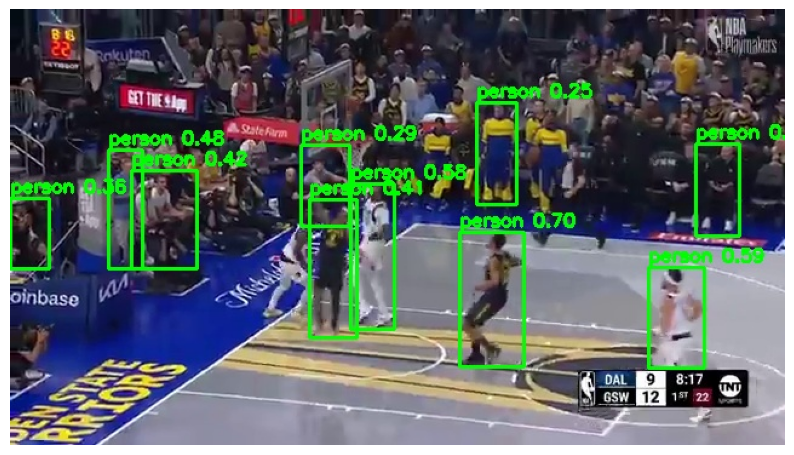

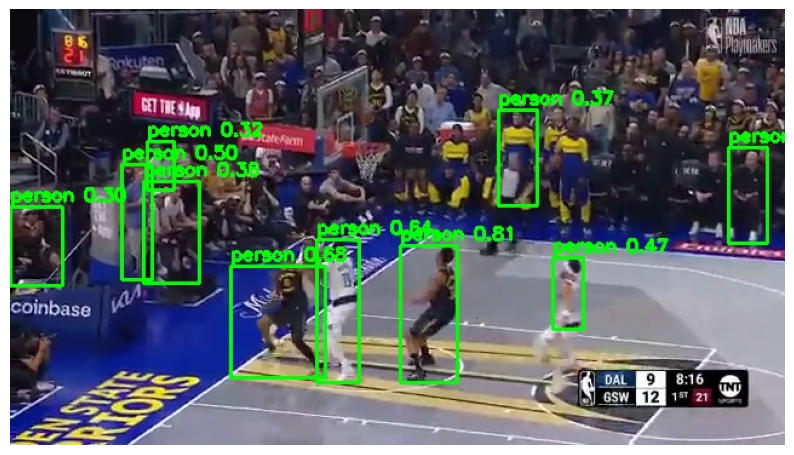

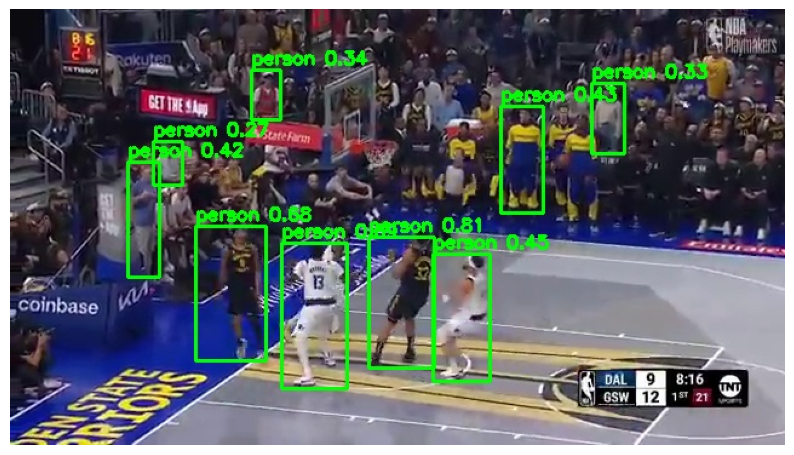

In [16]:
sample_frames = glob.glob(f"{filtered_output_dir}/*.jpg")[:3]

for frame in sample_frames:
    img = cv2.cvtColor(cv2.imread(frame), cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10,6))
    plt.imshow(img)
    plt.axis("off")
    plt.show()


In [17]:
def frames_to_video(frames_folder, output_video, fps=15):
    frames = sorted(glob.glob(os.path.join(frames_folder, "*.jpg")))
    if not frames:
        print("No frames found!")
        return

    # Get video dimensions
    frame = cv2.imread(frames[0])
    height, width, _ = frame.shape
    out = cv2.VideoWriter(output_video, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for frame_path in frames:
        img = cv2.imread(frame_path)
        out.write(img)
    out.release()
    print(f"Video saved at: {output_video}")

# Use the actual folder where your detections are stored
save_path = "/content/drive/MyDrive/NBA_Projects_Clips"

# Set input (frames) and output (video) paths
filtered_output_dir = f"{save_path}/detections_filtered"
video_output_path = f"{save_path}/out_of_bounds_saves_detected.mp4"

# Build the video
frames_to_video(filtered_output_dir, video_output_path, fps=15)


Video saved at: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_saves_detected.mp4


In [18]:
print(os.listdir(f"{save_path}/detections_filtered"))


['frame_0.jpg', 'frame_1.jpg', 'frame_2.jpg', 'frame_6.jpg', 'frame_5.jpg', 'frame_7.jpg', 'frame_9.jpg', 'frame_4.jpg', 'frame_8.jpg', 'frame_3.jpg', 'frame_11.jpg', 'frame_10.jpg', 'frame_12.jpg', 'frame_13.jpg', 'frame_14.jpg', 'frame_16.jpg', 'frame_17.jpg', 'frame_19.jpg', 'frame_18.jpg', 'frame_15.jpg', 'frame_21.jpg', 'frame_22.jpg', 'frame_23.jpg', 'frame_20.jpg', 'frame_27.jpg', 'frame_26.jpg', 'frame_24.jpg', 'frame_25.jpg', 'frame_29.jpg', 'frame_28.jpg', 'frame_30.jpg', 'frame_31.jpg', 'frame_33.jpg', 'frame_32.jpg', 'frame_35.jpg', 'frame_38.jpg', 'frame_40.jpg', 'frame_39.jpg', 'frame_34.jpg', 'frame_41.jpg', 'frame_36.jpg', 'frame_44.jpg', 'frame_43.jpg', 'frame_42.jpg', 'frame_47.jpg', 'frame_45.jpg', 'frame_46.jpg', 'frame_48.jpg', 'frame_49.jpg', 'frame_50.jpg', 'frame_52.jpg', 'frame_51.jpg', 'frame_37.jpg', 'frame_54.jpg', 'frame_55.jpg', 'frame_53.jpg', 'frame_57.jpg', 'frame_59.jpg', 'frame_58.jpg', 'frame_56.jpg', 'frame_60.jpg', 'frame_61.jpg', 'frame_63.jpg', '

In [19]:
video_output_path = f"{save_path}/out_of_bounds_saves_detected.mp4"
frames_to_video(f"{save_path}/detections_filtered", video_output_path, fps=15)


Video saved at: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_saves_detected.mp4


In [20]:
from IPython.display import Video
Video(video_output_path, embed=True)


In [21]:
from google.colab import files
files.download(video_output_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [22]:
def filter_main_lines(lines, orientation="vertical"):
    """Keep only the 2 longest vertical or horizontal lines."""
    if not lines:
        return []
    # Sort by line length
    lines = sorted(lines, key=lambda l: np.hypot(l[2]-l[0], l[3]-l[1]), reverse=True)
    return lines[:2]  # Keep top 2

def detect_court_lines(frame):
    """Detect major court lines using Hough Transform."""
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    edges = cv2.Canny(blur, 50, 150)
    lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=60, minLineLength=30, maxLineGap=20)
    vertical_lines, horizontal_lines = [], []

    if lines is not None:
        for x1, y1, x2, y2 in lines[:,0]:
            angle = np.degrees(np.arctan2(y2-y1, x2-x1))
            if abs(angle) < 10:  # horizontal
                horizontal_lines.append((x1, y1, x2, y2))
            elif abs(angle) > 80:  # vertical
                vertical_lines.append((x1, y1, x2, y2))

    # Filter to keep only main boundaries
    vertical_lines = filter_main_lines(vertical_lines, "vertical")
    horizontal_lines = filter_main_lines(horizontal_lines, "horizontal")
    return vertical_lines, horizontal_lines

def ball_center(box):
    """Get center of YOLO bounding box."""
    x1, y1, x2, y2 = box
    return int((x1+x2)/2), int((y1+y2)/2)

def process_frame_with_court(frame, detections):
    """Draw boundaries, detect ball crossing."""
    vertical_lines, horizontal_lines = detect_court_lines(frame)

    # Draw main court lines
    for x1, y1, x2, y2 in vertical_lines + horizontal_lines:
        cv2.line(frame, (x1, y1), (x2, y2), (0, 0, 255), 3)

    # Define court boundary box
    if vertical_lines and horizontal_lines:
        x_min = min([min(l[0], l[2]) for l in vertical_lines])
        x_max = max([max(l[0], l[2]) for l in vertical_lines])
        y_min = min([min(l[1], l[3]) for l in horizontal_lines])
        y_max = max([max(l[1], l[3]) for l in horizontal_lines])
    else:
        return frame, False  # No lines detected

    # Ball check
    ball_out = False
    for det in detections:
        cls, x1, y1, x2, y2 = det
        if cls == 32:  # ball
            cx, cy = ball_center((x1, y1, x2, y2))
            color = (0,255,0)
            if not (x_min < cx < x_max and y_min < cy < y_max):  # outside court box
                ball_out = True
                color = (0,0,255)
            cv2.circle(frame, (cx, cy), 8, color, -1)
    return frame, ball_out


In [23]:
from ultralytics import YOLO

# Load YOLO (pretrained on COCO)
model = YOLO("yolov8n.pt")
allowed_classes = [0, 32]  # person & sports ball

# Paths
frames_dir = f"{save_path}/frames/out_of_bounds_saves"
output_court_dir = f"{save_path}/detections_with_court"
os.makedirs(output_court_dir, exist_ok=True)

# Process each frame
frame_paths = sorted(glob.glob(os.path.join(frames_dir, "*.jpg")))

for frame_path in frame_paths:
    frame = cv2.imread(frame_path)
    results = model(frame_path)  # YOLO detections
    detections = []

    for r in results:
        for box in r.boxes:
            cls = int(box.cls)
            if cls in allowed_classes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                detections.append((cls, x1, y1, x2, y2))
                # Draw bounding boxes
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(frame, f"{model.names[cls]} {box.conf[0]:.2f}", (x1, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Process frame for court lines & ball position
    processed_frame, ball_out = process_frame_with_court(frame, detections)

    # Save processed frame
    cv2.imwrite(os.path.join(output_court_dir, os.path.basename(frame_path)), processed_frame)

print(f"Processed frames with court detection saved at: {output_court_dir}")



image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_0.jpg: 384x640 10 persons, 244.5ms
Speed: 3.3ms preprocess, 244.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_1.jpg: 384x640 10 persons, 162.1ms
Speed: 1.8ms preprocess, 162.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_10.jpg: 384x640 5 persons, 1 backpack, 149.4ms
Speed: 1.7ms preprocess, 149.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_11.jpg: 384x640 4 persons, 2 umbrellas, 1 sports ball, 167.3ms
Speed: 1.9ms preprocess, 167.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/fram

In [24]:
video_output_path = f"{save_path}/out_of_bounds_with_court.mp4"
frames_to_video(output_court_dir, video_output_path, fps=15)
print(f"Video created: {video_output_path}")


Video saved at: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_with_court.mp4
Video created: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_with_court.mp4


In [25]:
events_log = []
fps = 15

for idx, frame_path in enumerate(frame_paths):
    frame = cv2.imread(frame_path)
    results = model(frame_path)
    detections = []

    for r in results:
        for box in r.boxes:
            cls = int(box.cls)
            if cls in allowed_classes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                detections.append((cls, x1, y1, x2, y2))
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(frame, f"{model.names[cls]} {box.conf[0]:.2f}", (x1, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    processed_frame, ball_out = process_frame_with_court(frame, detections)
    cv2.imwrite(os.path.join(output_court_dir, os.path.basename(frame_path)), processed_frame)

    # Log if ball is out
    if ball_out:
        timestamp = idx / fps
        events_log.append({"frame": idx, "timestamp_sec": round(timestamp, 2)})

# Save events to CSV
events_df = pd.DataFrame(events_log)
events_csv_path = f"{save_path}/out_of_bounds_events.csv"
events_df.to_csv(events_csv_path, index=False)
print(f"Out-of-bounds events logged at: {events_csv_path}")



image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_0.jpg: 384x640 10 persons, 148.7ms
Speed: 1.9ms preprocess, 148.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_1.jpg: 384x640 10 persons, 153.5ms
Speed: 1.9ms preprocess, 153.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_10.jpg: 384x640 5 persons, 1 backpack, 153.2ms
Speed: 1.8ms preprocess, 153.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_11.jpg: 384x640 4 persons, 2 umbrellas, 1 sports ball, 154.0ms
Speed: 1.8ms preprocess, 154.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/fram

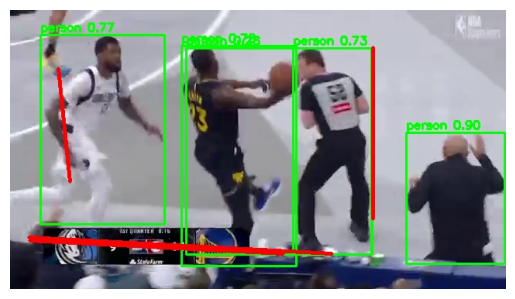

In [26]:

img = cv2.imread(os.path.join(output_court_dir, "frame_10.jpg"))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


In [27]:

def euclidean_distance(p1, p2):
    """Compute distance between two points."""
    return math.sqrt((p1[0]-p2[0])**2 + (p1[1]-p2[1])**2)

def find_last_touch(detections, ball_center):
    """Find closest player to the ball."""
    min_dist = float('inf')
    last_touch_player = None
    for i, det in enumerate(detections):
        cls, x1, y1, x2, y2 = det
        if cls == 0:  # player
            player_center = ((x1+x2)//2, (y1+y2)//2)
            dist = euclidean_distance(ball_center, player_center)
            if dist < min_dist:
                min_dist = dist
                last_touch_player = f"Player_{i+1}"
    return last_touch_player

# ---- Modified Process Frame ----
def process_frame_with_court(frame, detections):
    vertical_lines, horizontal_lines = detect_court_lines(frame)
    for x1, y1, x2, y2 in vertical_lines + horizontal_lines:
        cv2.line(frame, (x1, y1), (x2, y2), (0, 0, 255), 3)
    if vertical_lines and horizontal_lines:
        x_min = min([min(l[0], l[2]) for l in vertical_lines])
        x_max = max([max(l[0], l[2]) for l in vertical_lines])
        y_min = min([min(l[1], l[3]) for l in horizontal_lines])
        y_max = max([max(l[1], l[3]) for l in horizontal_lines])
    else:
        return frame, False, None

    ball_out = False
    last_touch_player = None
    for det in detections:
        cls, x1, y1, x2, y2 = det
        if cls == 32:
            cx, cy = ball_center((x1,y1,x2,y2))
            color = (0,255,0)
            if not (x_min < cx < x_max and y_min < cy < y_max):
                ball_out = True
                color = (0,0,255)
                last_touch_player = find_last_touch(detections, (cx, cy))
            cv2.circle(frame, (cx, cy), 8, color, -1)
    # Overlay last-touch info
    if ball_out and last_touch_player:
        cv2.putText(frame, f"Last touch: {last_touch_player}", (50,50),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 2)
    return frame, ball_out, last_touch_player

# ---- YOLO Loop with Last Touch ----
events_log = []
for idx, frame_path in enumerate(frame_paths):
    frame = cv2.imread(frame_path)
    results = model(frame_path)
    detections = []
    for r in results:
        for box in r.boxes:
            cls = int(box.cls)
            if cls in allowed_classes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                detections.append((cls, x1, y1, x2, y2))
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(frame, f"{model.names[cls]} {box.conf[0]:.2f}", (x1, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    processed_frame, ball_out, last_touch_player = process_frame_with_court(frame, detections)
    cv2.imwrite(os.path.join(output_court_dir, os.path.basename(frame_path)), processed_frame)
    if ball_out:
        events_log.append({
            "frame": idx,
            "timestamp_sec": round(idx/fps,2),
            "last_touch_player": last_touch_player
        })

# ---- Save Enhanced CSV ----
events_df = pd.DataFrame(events_log)
events_df.to_csv(events_csv_path, index=False)
print(f"Pipeline updated with last-touch! Events logged at: {events_csv_path}")



image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_0.jpg: 384x640 10 persons, 238.9ms
Speed: 2.0ms preprocess, 238.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_1.jpg: 384x640 10 persons, 230.1ms
Speed: 4.0ms preprocess, 230.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_10.jpg: 384x640 5 persons, 1 backpack, 228.2ms
Speed: 3.9ms preprocess, 228.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/frame_11.jpg: 384x640 4 persons, 2 umbrellas, 1 sports ball, 272.4ms
Speed: 3.8ms preprocess, 272.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/drive/MyDrive/NBA_Projects_Clips/frames/out_of_bounds_saves/fram

In [28]:
events_df = pd.read_csv(events_csv_path)
events_df.head(10)


,frame,timestamp_sec,last_touch_player
0,3,0.20,Player_2
1,35,2.33,Player_9
2,89,5.93,Player_7


In [29]:
video_output_path = f"{save_path}/out_of_bounds_with_last_touch.mp4"
frames_to_video(output_court_dir, video_output_path, fps=15)
Video(video_output_path, embed=True)


Video saved at: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_with_last_touch.mp4


In [30]:
def build_highlights(frames_folder, events_df, output_video, context_frames=15):
    """Create a highlights video with a few seconds before & after each event."""
    frames = sorted(glob.glob(os.path.join(frames_folder, "*.jpg")))
    event_frames = events_df['frame'].tolist()
    selected_frames = set()

    for ef in event_frames:
        for i in range(ef - context_frames, ef + context_frames + 1):
            if 0 <= i < len(frames):
                selected_frames.add(i)

    selected_frames = sorted(selected_frames)
    if not selected_frames:
        print("No highlights to create.")
        return

    # Prepare video writer
    sample_frame = cv2.imread(frames[selected_frames[0]])
    height, width, _ = sample_frame.shape
    out = cv2.VideoWriter(output_video, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for idx in selected_frames:
        frame = cv2.imread(frames[idx])
        out.write(frame)

    out.release()
    print(f"Highlights video saved at: {output_video}")

# Run highlights builder
events_df = pd.read_csv(events_csv_path)
highlights_path = f"{save_path}/out_of_bounds_highlights.mp4"
build_highlights(output_court_dir, events_df, highlights_path, context_frames=15)

# Preview in Colab
from IPython.display import Video
Video(highlights_path, embed=True)


Highlights video saved at: /content/drive/MyDrive/NBA_Projects_Clips/out_of_bounds_highlights.mp4
